In [2]:
import scvelo as scv
import scanpy as sc, numpy as np, pandas as  pd, anndata as ad

In [3]:
scv.settings.verbosity = 3
scv.settings.set_figure_params('scvelo', facecolor='white', dpi=150, frameon=False)

# Step 1: Load Data

In [33]:
adata = sc.read_h5ad('../data/processed/cells_postprocessed.h5ad')

In [34]:
# load loom files for spliced/unspliced matrices
ldata = scv.read('../data/processed/Pituitary_velocyto_all.loom', cache=True)
ldata.var_names_make_unique()

In [35]:
# merge matrices into the original adata object
adata = scv.utils.merge(adata, ldata)

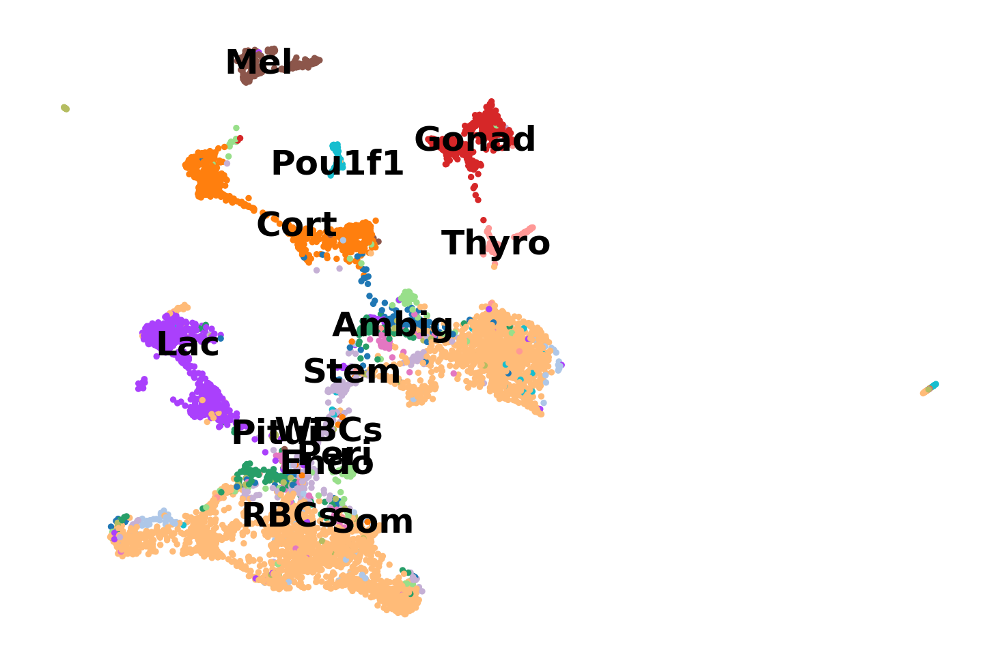

In [7]:
# plot umap to check
sc.pl.umap(adata, color='cell_type_brief', frameon=False, legend_loc='on data', title='')

In [8]:
# subsetting anndata object
hdata = adata[adata.obs.cell_type_brief.isin(['Som','Lac','Cort','Mel','Gonad','Thyro'])]

In [9]:
hdata = hdata[hdata.obs.treat.isin(['Saline','LPS'])]

# Step 2-1: Hormone producing cells (HPCs)
## Step 2-1-1: Recompute UMAP embedding

In [10]:
sc.pp.normalize_total(hdata, target_sum=1e4)
sc.pp.log1p(hdata)
sc.pp.highly_variable_genes(hdata, min_mean=0.0125, max_mean=3, min_disp=0.5)
hdata.raw = hdata
hdata = hdata[:, hdata.var.highly_variable]
sc.pp.regress_out(hdata, ['nCount_RNA','subsets_Mito_detected','subsets_Ribo_detected'])
sc.pp.scale(hdata, max_value=10)

In [11]:
sc.tl.pca(hdata, svd_solver='arpack')
sc.pp.neighbors(hdata, n_neighbors=15, n_pcs=50)
sc.tl.umap(hdata)

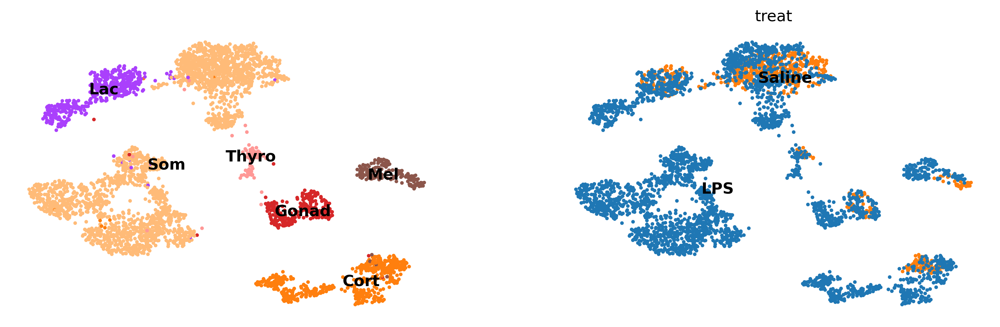

In [14]:
# plot umap to check
sc.pl.umap(hdata, color=['cell_type_brief','treat'], frameon=False, legend_loc='on data', title='')

## Step 2-1-2: Computing RNA velocity using scVelo

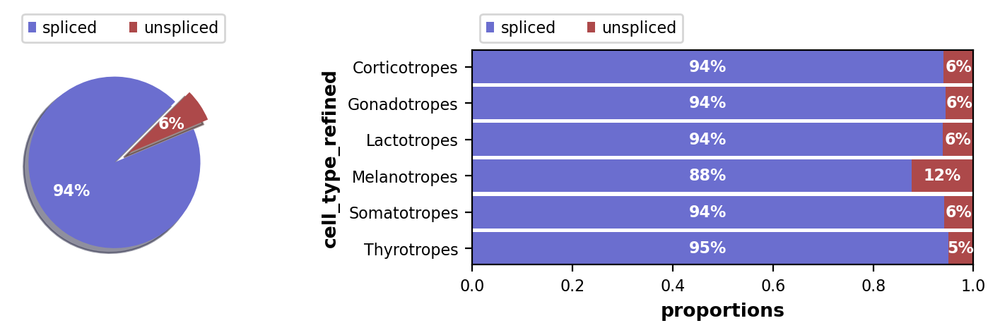

In [15]:
scv.pl.proportions(hdata, groupby='cell_type_refined')

In [16]:
# pre-process
scv.pp.filter_and_normalize(hdata)
scv.pp.moments(hdata)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [17]:
# compute velocity using the steady-state model (La Manno., 2018), i.e. mode='stochastic'
scv.tl.velocity(hdata, mode='stochastic')
scv.tl.velocity_graph(hdata)

computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/48 cores)


  0%|          | 0/3873 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


## Step 2-1-3: Visualize velocity fields

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_embedding.pdf


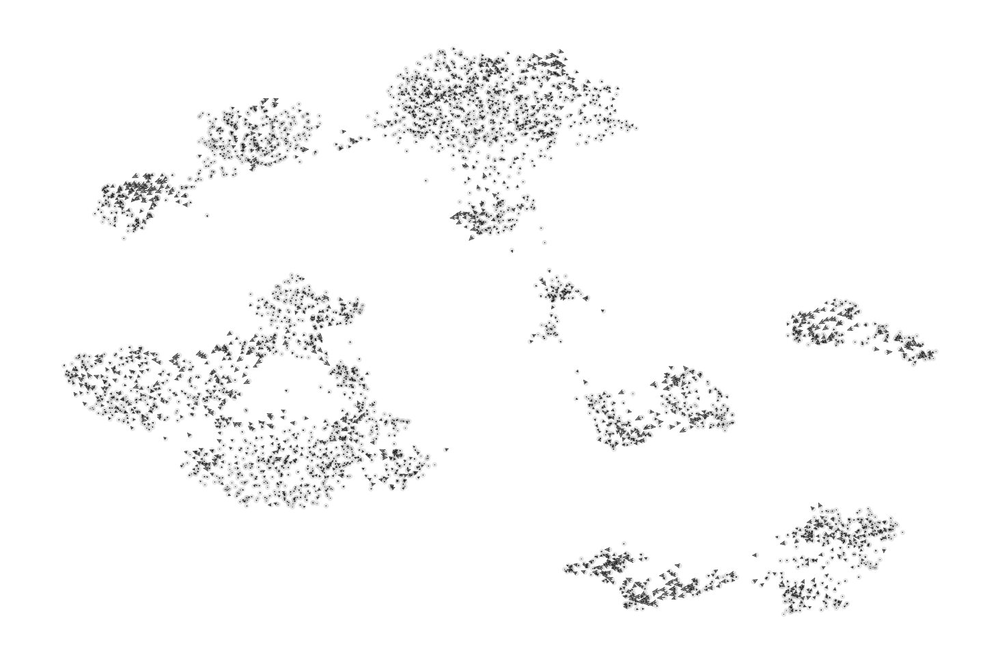

In [18]:
scv.pl.velocity_embedding(hdata, basis='umap', frameon=False, save='embedding.pdf')

saving figure to file ./figures/scvelo_embedding_grid.pdf


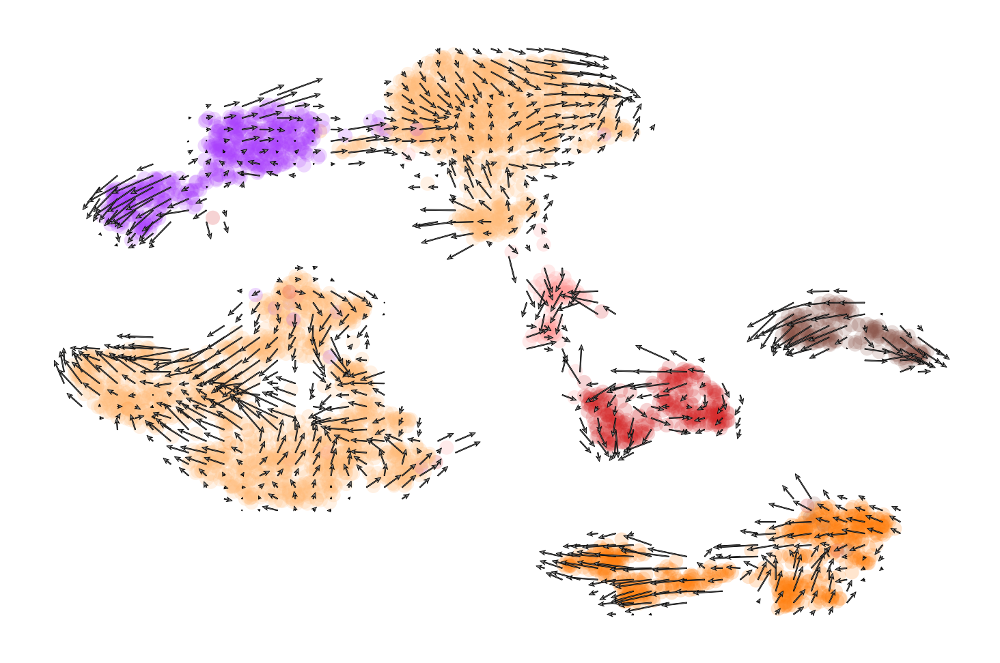

In [19]:
scv.pl.velocity_embedding_grid(hdata, basis='umap', color='cell_type_brief', save='embedding_grid.pdf', title='', scale=0.25)

saving figure to file ./figures/scvelo_embedding_stream.png


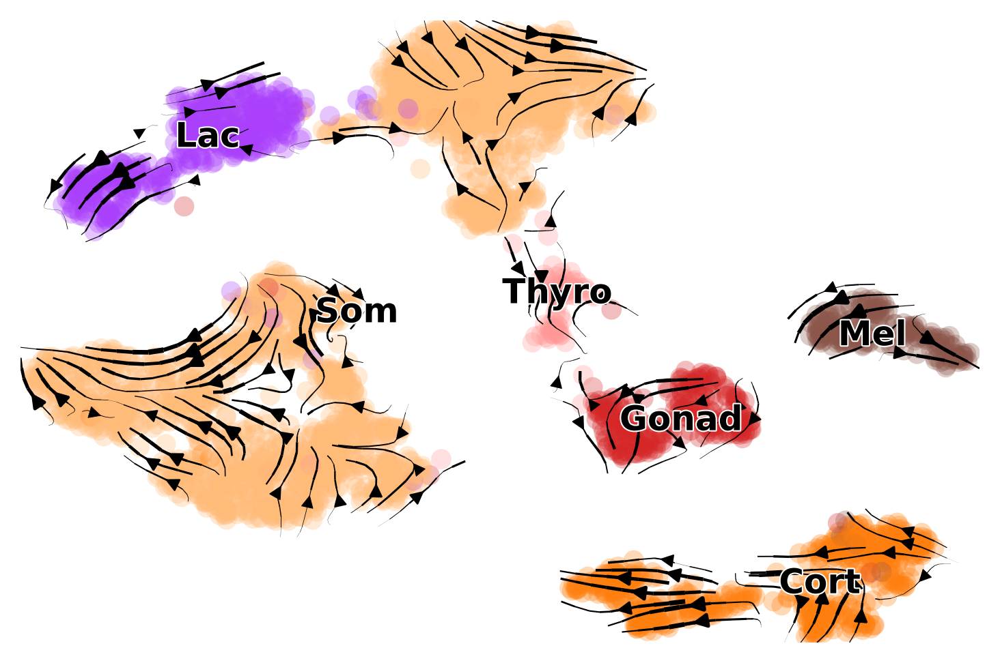

In [20]:
scv.pl.velocity_embedding_stream(hdata, basis='umap', color=['cell_type_brief'], save='embedding_stream.png', title='')

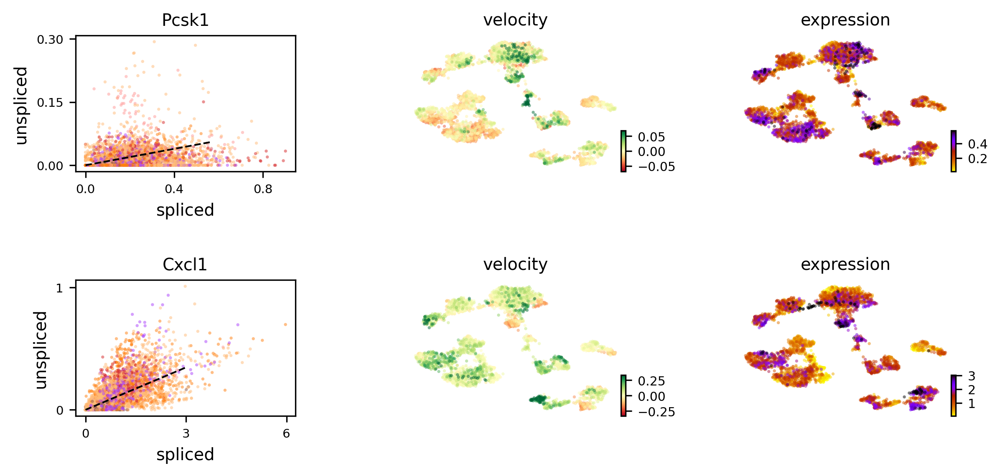

In [22]:
# plot velocity of a selected gene
scv.pl.velocity(hdata, var_names=['Pcsk1','Cxcl1'], color='cell_type_brief', ncols=1)

# Step 2-2: Corticotropes
## Step 2-2-1: Data preparation and pre-processing

In [38]:
cort = adata[adata.obs.cell_type_brief == "Cort"]
cort = cort[cort.obs.treat.isin(['Saline','LPS'])]

In [39]:
sc.pp.normalize_total(cort, target_sum=1e4)
sc.pp.log1p(cort)
sc.pp.highly_variable_genes(cort, min_mean=0.0125, max_mean=3, min_disp=0.5)
cort.raw = cort
cort = cort[:, cort.var.highly_variable]
sc.pp.regress_out(cort, ['nCount_RNA','subsets_Mito_detected','subsets_Ribo_detected'])
sc.pp.scale(cort, max_value=10)

In [40]:
sc.tl.pca(cort, svd_solver='arpack')
sc.pp.neighbors(cort, n_neighbors=15, n_pcs=50)
sc.tl.umap(cort)

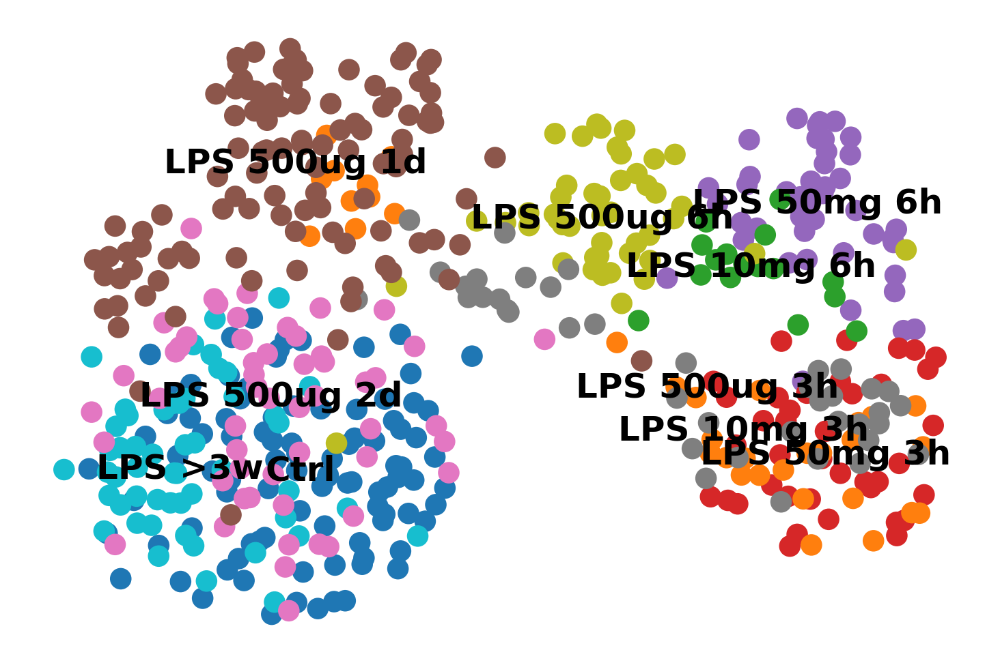

In [41]:
# plot umap to check
sc.pl.umap(cort, color=['stim'], frameon=False, legend_loc='on data', title='')

## Step 2-2-2: Computing RNA velocity using scVelo

In [43]:
# pre-process
scv.pp.filter_and_normalize(cort)
scv.pp.moments(cort)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [44]:
# compute velocity using the steady-state model (La Manno., 2018), i.e. mode='stochastic'
scv.tl.velocity(cort, mode='stochastic')
scv.tl.velocity_graph(cort)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/48 cores)


  0%|          | 0/523 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


## Step 2-2-3: Visualize velocity fields

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


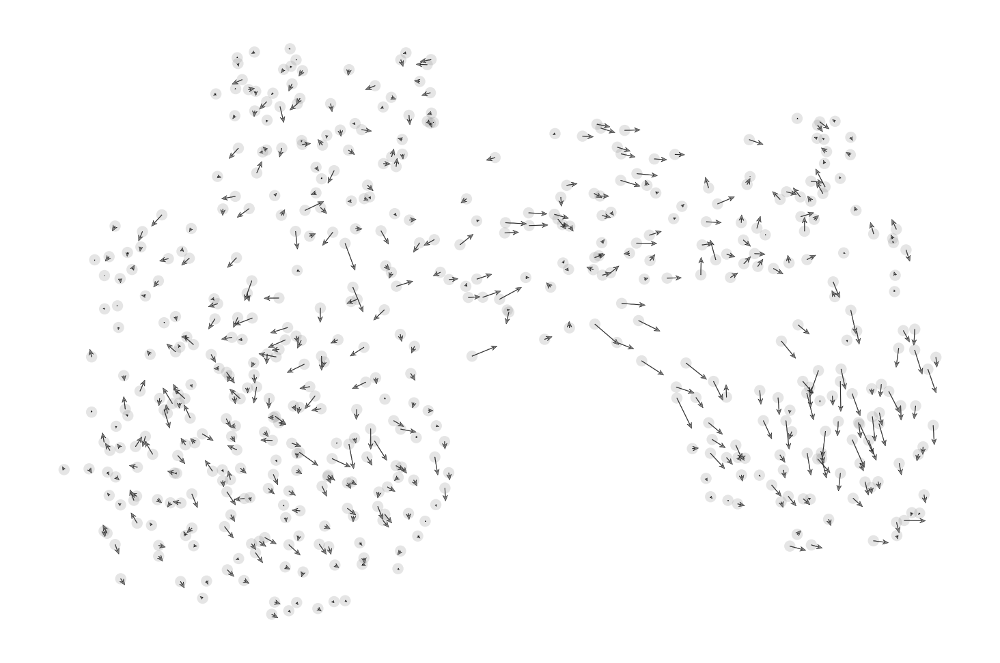

In [45]:
scv.pl.velocity_embedding(cort, basis='umap', frameon=False)

saving figure to file ./figures/scvelo_cort_embedding_grid.pdf


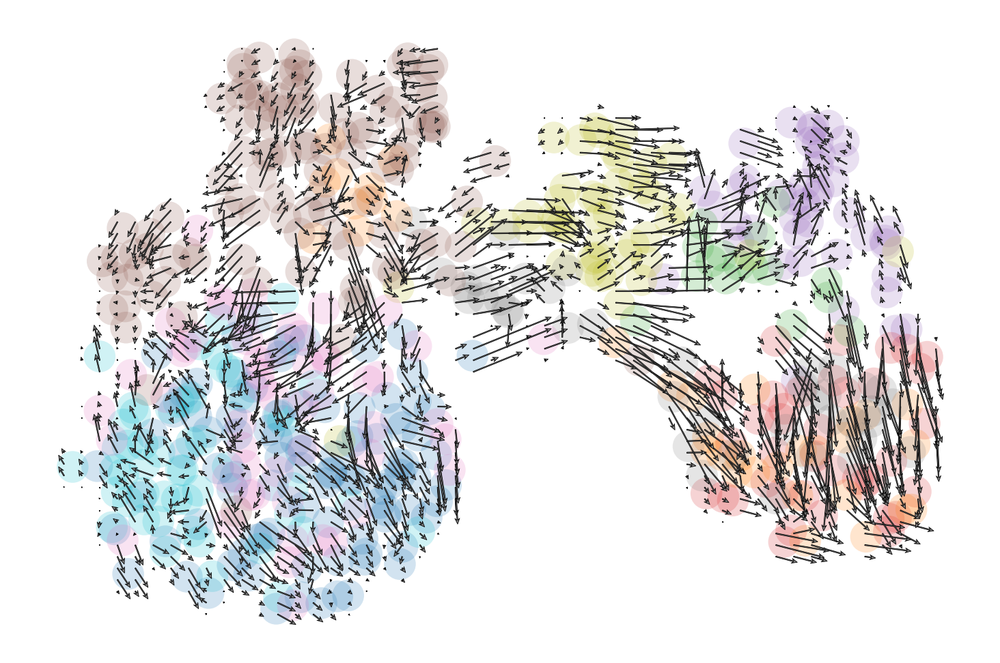

In [48]:
scv.pl.velocity_embedding_grid(cort, basis='umap', color='stim', save='cort_embedding_grid.pdf', title='', scale=0.25)

saving figure to file ./figures/scvelo_cort_embedding_stream.png


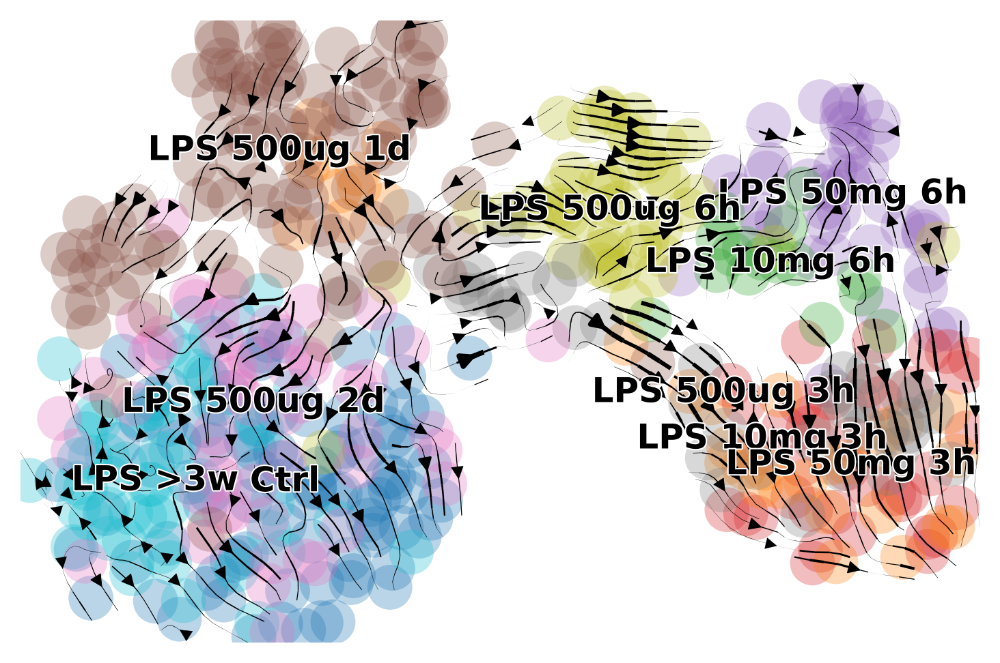

In [49]:
scv.pl.velocity_embedding_stream(cort, basis='umap', color=['stim'], save='cort_embedding_stream.png', title='')

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_cort_pca_embedding_grid.pdf


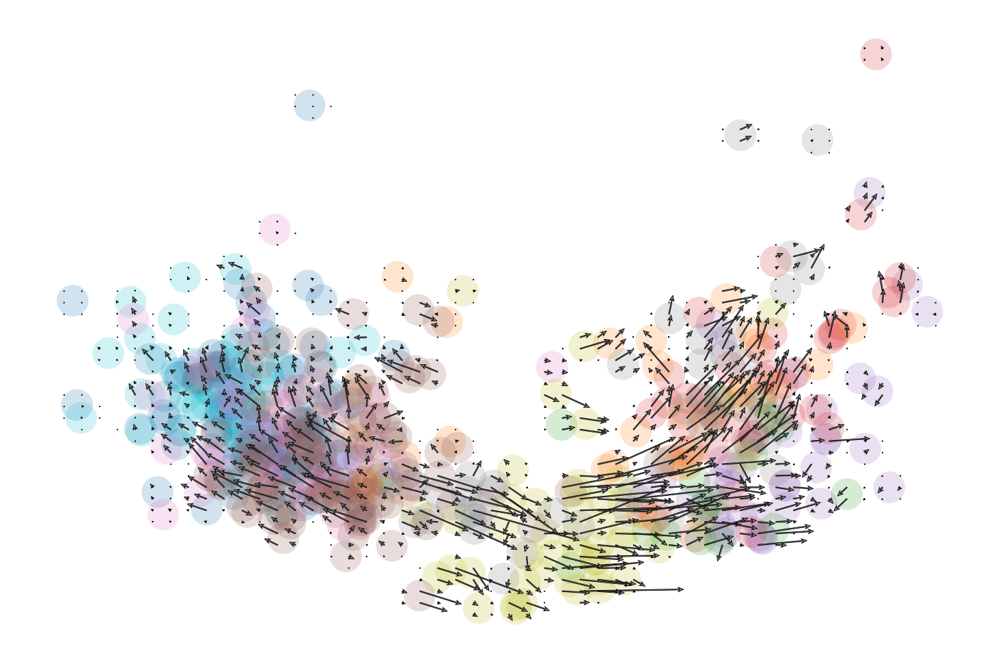

In [50]:
scv.pl.velocity_embedding_grid(cort, basis='pca', color='stim', save='cort_pca_embedding_grid.pdf', title='', scale=0.25)

saving figure to file ./figures/scvelo_cort_pca_embedding_stream.png


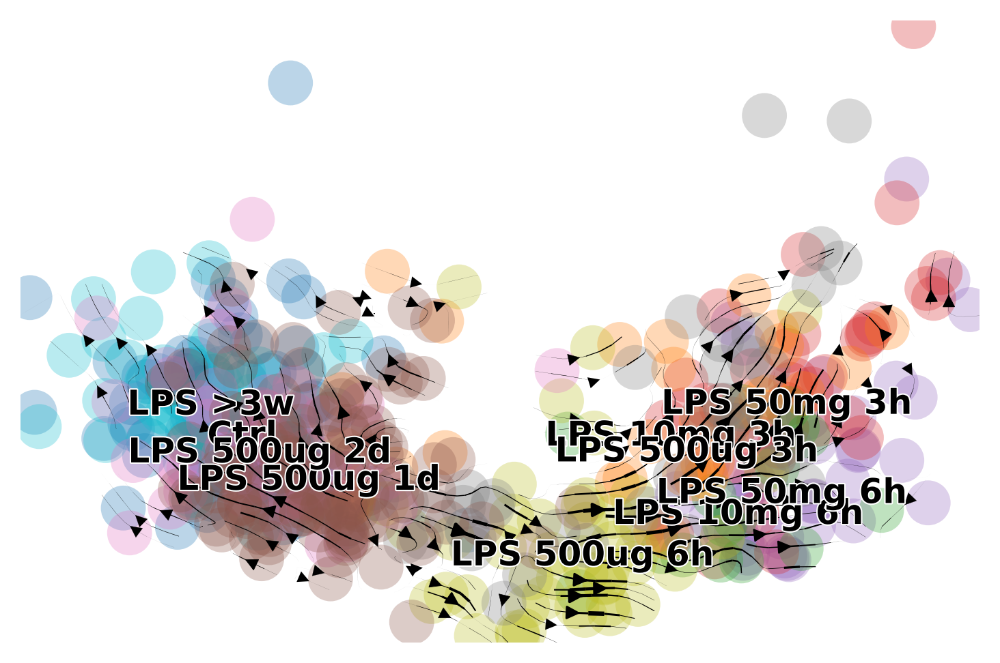

In [51]:
scv.pl.velocity_embedding_stream(cort, basis='pca', color=['stim'], save='cort_pca_embedding_stream.png', title='')

## Step 2-2-3: Dynamic model

In [52]:
sc.tl.pca(cort, svd_solver='arpack')
sc.pp.neighbors(cort, n_neighbors=15, use_rep='X_pca')
sc.tl.umap(cort)

In [53]:
# pre-process
scv.pp.filter_and_normalize(cort)
scv.pp.moments(cort)

computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [54]:
scv.tl.recover_dynamics(cort)

recovering dynamics (using 1/48 cores)


  0%|          | 0/127 [00:00<?, ?gene/s]

    finished (0:00:17) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [55]:
# compute velocity using the dynamical model (Bergen., 2020), i.e. mode='dynamical'
scv.tl.velocity(cort, mode='dynamical')
scv.tl.velocity_graph(cort)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/48 cores)


  0%|          | 0/523 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


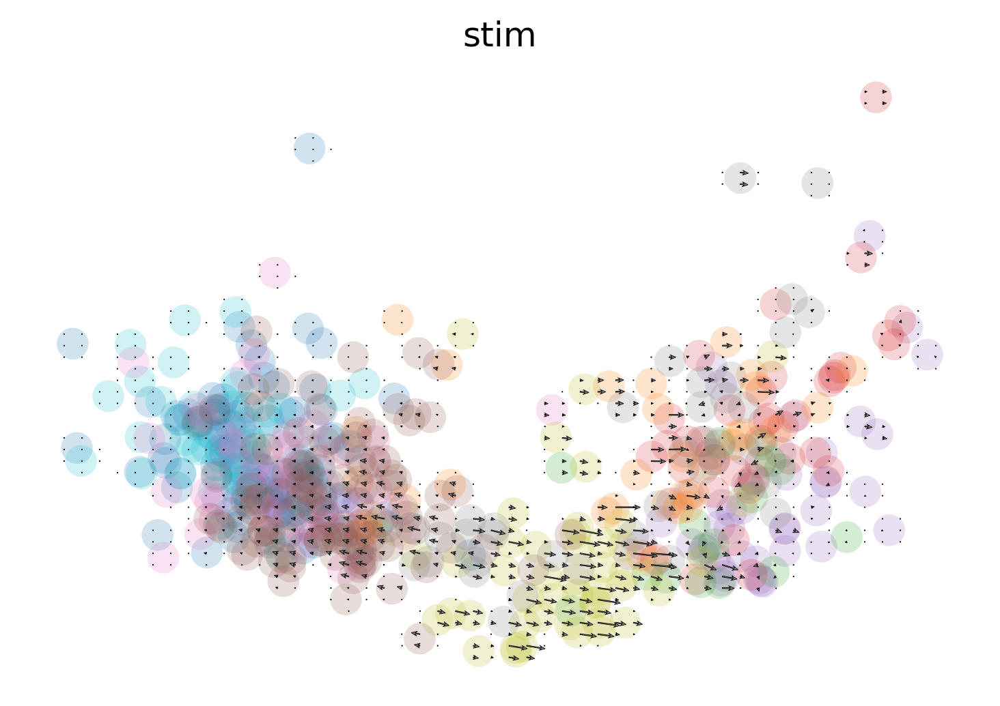

In [57]:
scv.pl.velocity_embedding_grid(cort, basis='pca',color='stim')

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


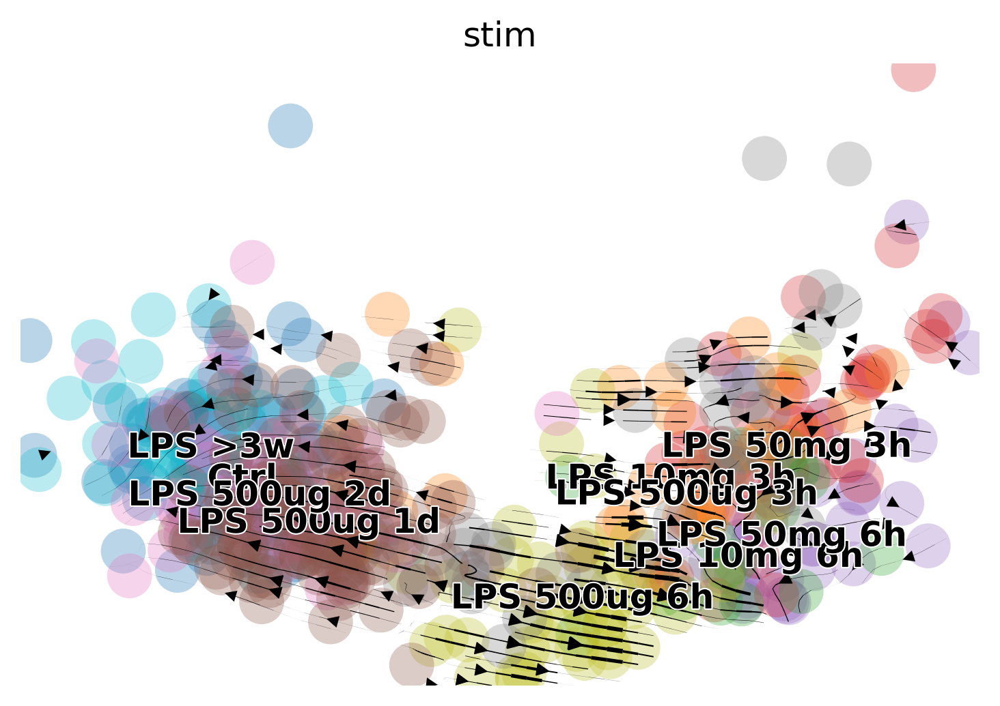

In [56]:
scv.pl.velocity_embedding_stream(cort, basis='pca',color='stim')

# Step 3: Downstream analysis

In [58]:
scv.tl.rank_velocity_genes(hdata, groupby='cell_type_brief', min_corr=.3)

ranking velocity genes
    finished (0:00:04) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [59]:
df = scv.DataFrame(hdata.uns['rank_velocity_genes']['names'])
df.head()

,Cort,Gonad,Lac,Mel,Som,Thyro
0,Rsad2,Cxcl1,Hspa5,Oacyl,Defb1,Chgb
1,Steap4,Rsad2,Chgb,Pcsk2,Gnrhr,Ms4a6c
2,Saa2,Saa2,Chrne,Rbfox3,Chgb,Rbfox3
3,Defb1,Cp,Ms4a6c,Cp,Chrne,Steap4
4,Chrne,Hspa5,Ptprc,Ptprc,Hspa5,Gnrhr


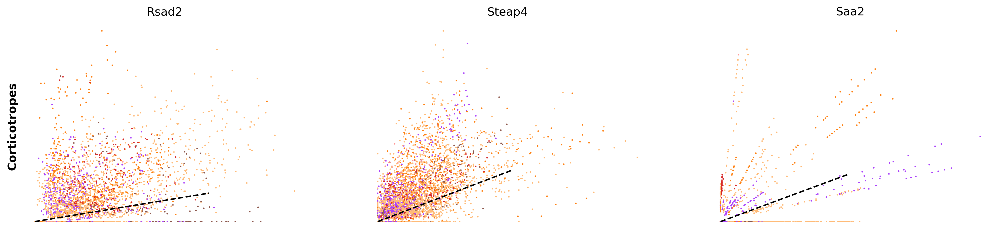

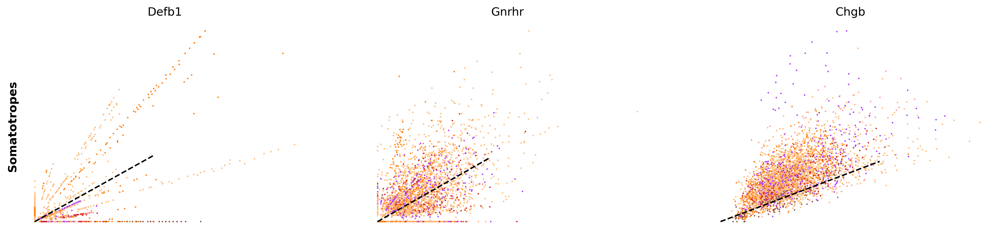

In [60]:
kwargs = dict(frameon=False, size=10, linewidth=1.5,
             add_outline='Corticotropes, Somatotropes')
scv.pl.scatter(hdata, df['Cort'][:3], ylabel='Corticotropes', frameon=False, color='cell_type_brief', size=10, linewidth=1.5)
scv.pl.scatter(hdata, df['Som'][:3], ylabel='Somatotropes', frameon=False, color='cell_type_brief', size=10, linewidth=1.5)

* Speed: length of the velocity vector
* Coherence: how well a velocity vector correlates to its neighbors

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


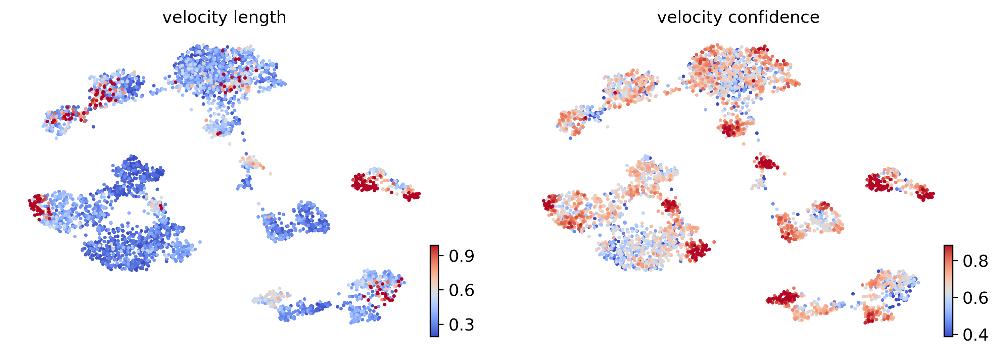

In [61]:
scv.tl.velocity_confidence(hdata)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(hdata, c=keys, cmap='coolwarm', perc=[5,95])

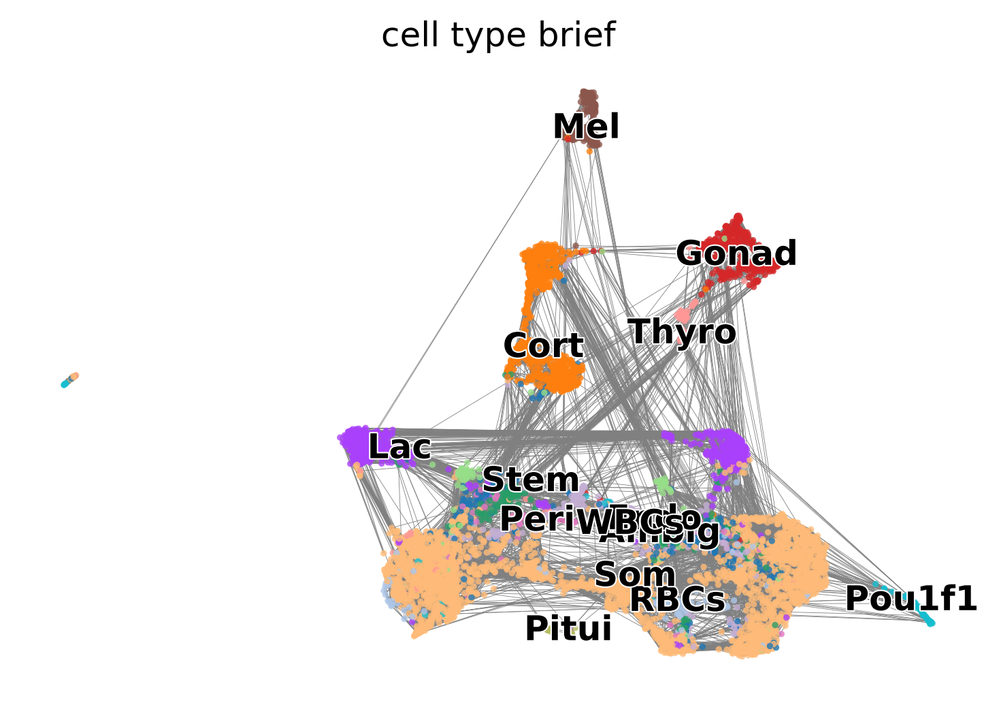

In [30]:
scv.pl.velocity_graph(adata, threshold=.1, color='cell_type_brief')

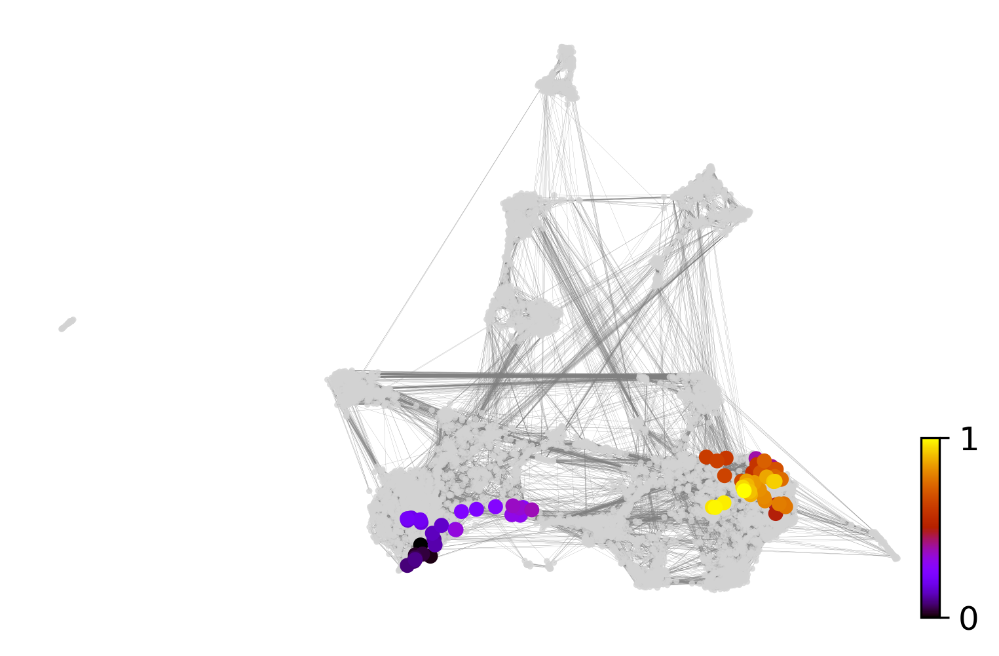

In [31]:
x, y = scv.utils.get_cell_transitions(adata, basis='umap', starting_cell=70)
ax = scv.pl.velocity_graph(adata, c='lightgrey', edge_width=.05, show=False)
ax = scv.pl.scatter(adata, x=x, y=y, s=120, c='ascending', cmap='gnuplot', ax=ax)

computing terminal states
    identified 4 regions of root cells and 3 regions of end points .
    finished (0:00:01) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


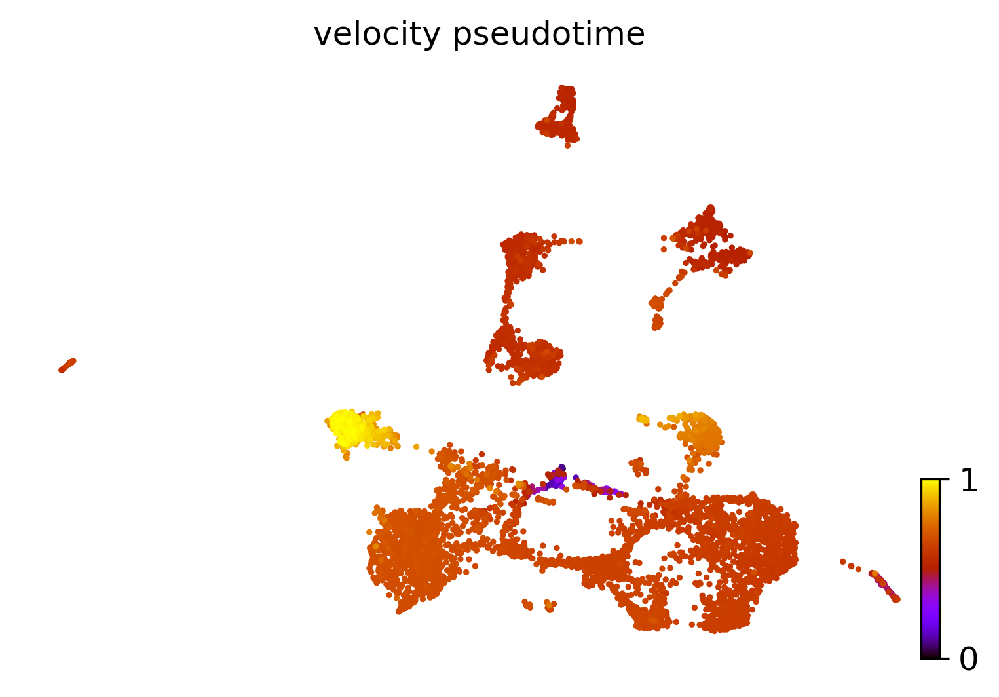

In [32]:
scv.tl.velocity_pseudotime(adata)
scv.pl.scatter(adata, color='velocity_pseudotime', cmap='gnuplot')

In [33]:
# this is needed due to a current bug - bugfix is coming soon.
adata.uns['neighbors']['distances'] = adata.obsp['distances']
adata.uns['neighbors']['connectivities'] = adata.obsp['connectivities']

In [34]:
## BUG: no 'paga/transitions_confidence' specified
scv.tl.paga(adata, groups = 'cell_type_brief')
df = scv.get_df(adata, '../data/processed/scvelo/transitions_confidence', precision=2).T

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:01) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


OptionError: 'Pattern matched multiple keys'

In [ ]:
## BUG: no 'paga/transitions_confidence' specified
scv.pl.paga(adata, basis='umap', size=50, alpha=.1,
           min_edge_width=2, node_size_scale=1.5)

In [66]:
sc.pp.normalize_total(pou1f1_lineage, target_sum=1e4)
sc.pp.log1p(pou1f1_lineage)
sc.pp.highly_variable_genes(pou1f1_lineage, min_mean=0.0125, max_mean=3, min_disp=0.5)
pou1f1_lineage.raw = pou1f1_lineage
pou1f1_lineage = pou1f1_lineage[:, pou1f1_lineage.var.highly_variable]
sc.pp.regress_out(pou1f1_lineage, ['nCount_RNA','subsets_Mito_detected','subsets_Ribo_detected'])
sc.pp.scale(pou1f1_lineage, max_value=10)

In [67]:
sc.tl.pca(pou1f1_lineage, svd_solver='arpack')
sc.pp.neighbors(pou1f1_lineage, n_neighbors=15, n_pcs=50)
sc.tl.umap(pou1f1_lineage)

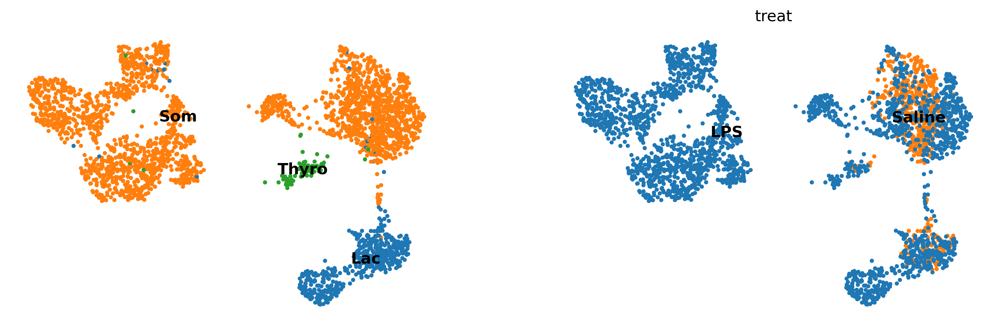

In [68]:
# plot umap to check
sc.pl.umap(pou1f1_lineage, color=['cell_type_brief','treat'], frameon=False, legend_loc='on data', title='')

In [69]:
scv.pp.filter_and_normalize(pou1f1_lineage, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(pou1f1_lineage, n_pcs=30, n_neighbors=30)

Filtered out 6079 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [92]:
scv.tl.recover_dynamics(pou1f1_lineage)

recovering dynamics (using 1/48 cores)


  0%|          | 0/47 [00:00<?, ?gene/s]

    finished (0:00:15) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [93]:
scv.tl.velocity(pou1f1_lineage, mode='dynamical')
scv.tl.velocity_graph(pou1f1_lineage)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/48 cores)


  0%|          | 0/2903 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


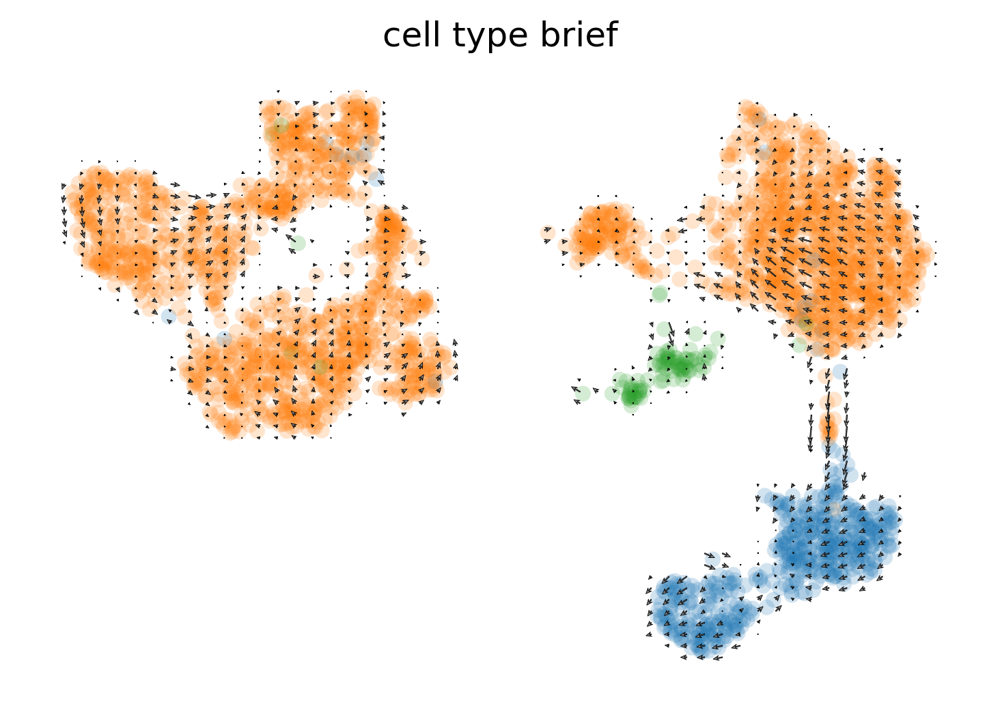

In [75]:
scv.pl.velocity_embedding_grid(pou1f1_lineage, color='cell_type_brief', basis='umap')

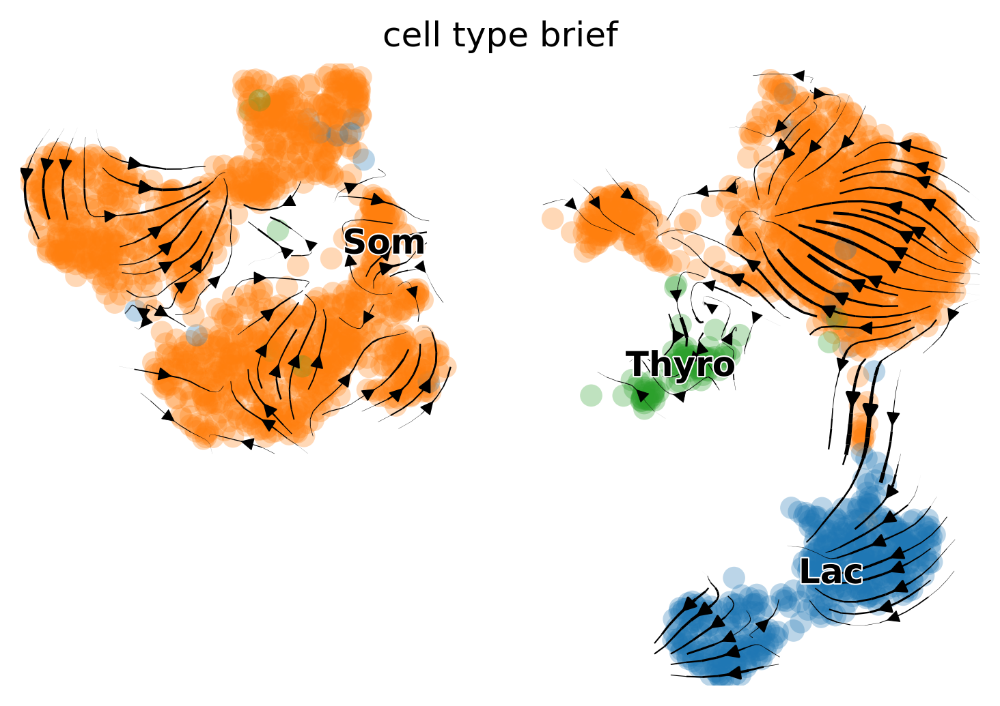

In [73]:
scv.pl.velocity_embedding_stream(pou1f1_lineage, color='cell_type_brief', basis='umap')

In [76]:
scv.tl.velocity(pou1f1_lineage, mode='stochastic')
scv.tl.velocity_graph(pou1f1_lineage)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/48 cores)


  0%|          | 0/2903 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


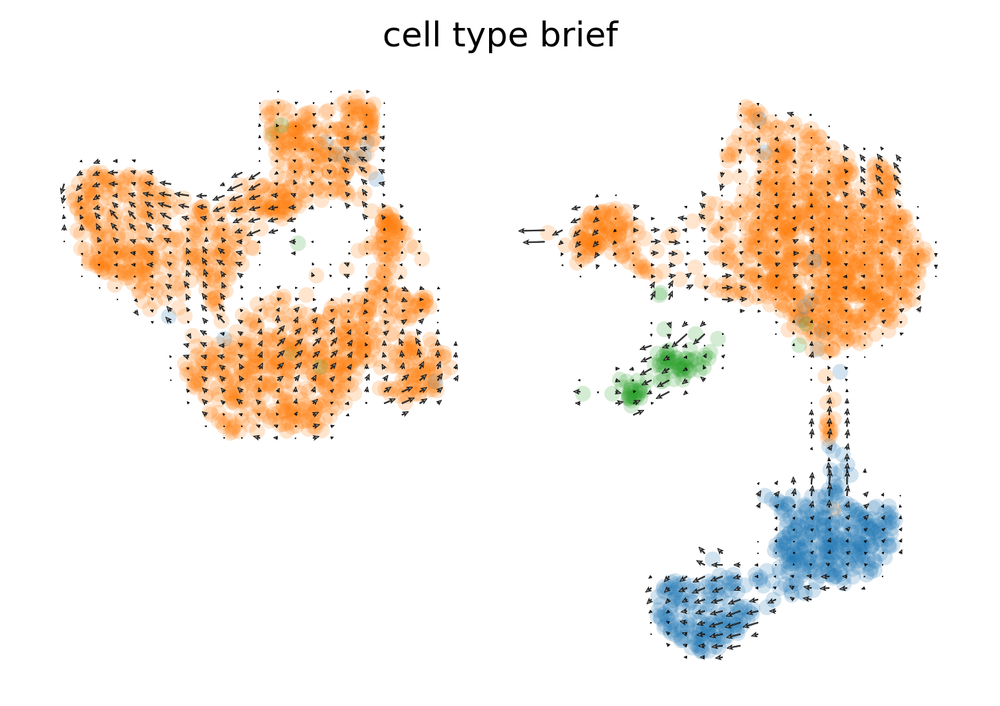

In [77]:
scv.pl.velocity_embedding_grid(pou1f1_lineage, color='cell_type_brief', basis='umap')

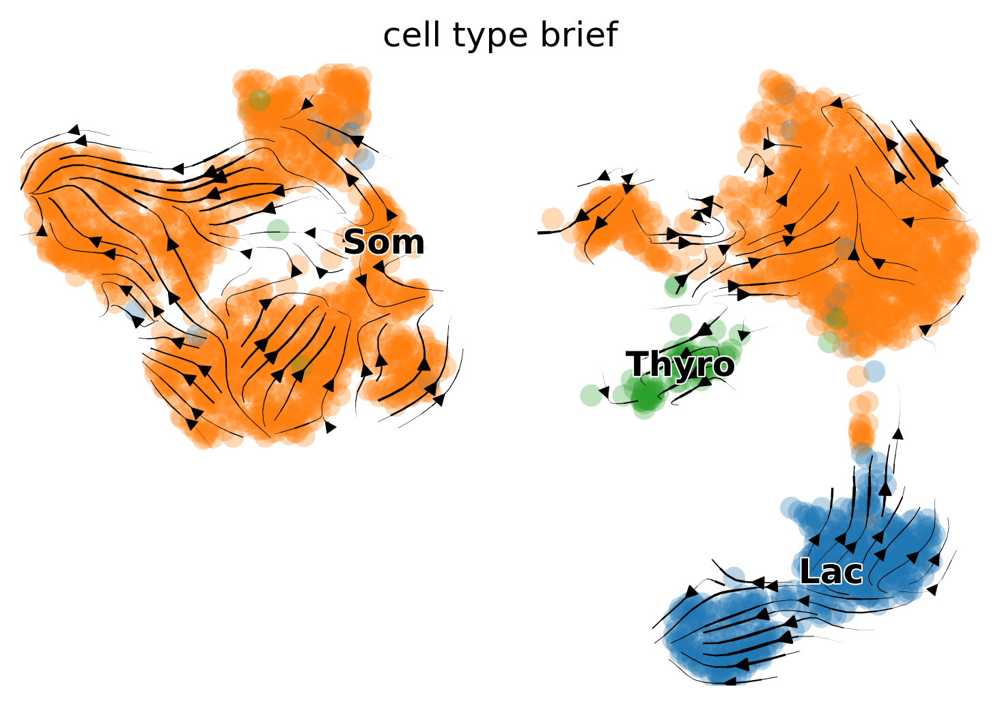

In [78]:
scv.pl.velocity_embedding_stream(pou1f1_lineage, color='cell_type_brief', basis='umap')

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)


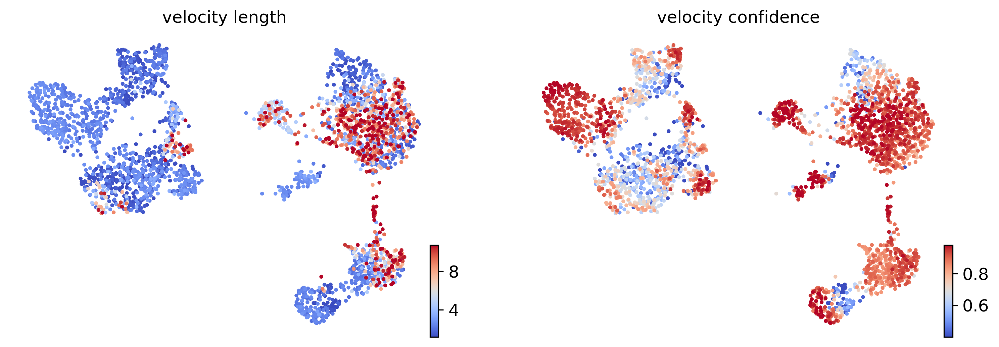

In [94]:
scv.tl.velocity_confidence(pou1f1_lineage)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(pou1f1_lineage, c=keys, cmap='coolwarm', perc=[5,95])

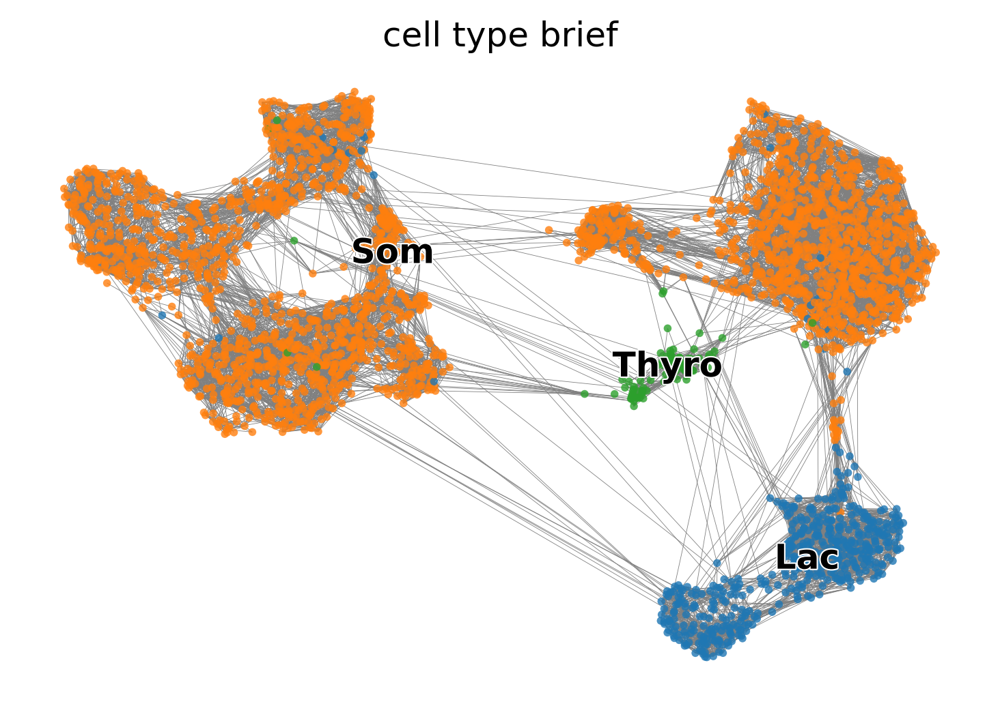

In [96]:
scv.pl.velocity_graph(pou1f1_lineage, threshold=.1, color='cell_type_brief', legend_loc='on data')

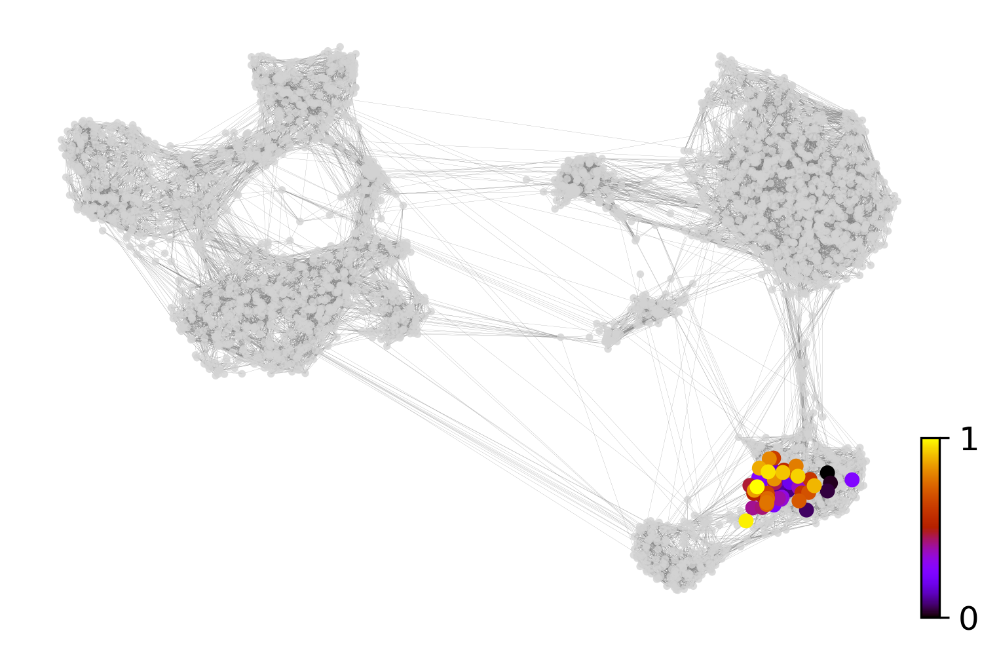

In [100]:
x, y = scv.utils.get_cell_transitions(pou1f1_lineage, basis='umap', starting_cell=1)
ax = scv.pl.velocity_graph(pou1f1_lineage, c='lightgrey', edge_width=.05, show=False)
ax = scv.pl.scatter(pou1f1_lineage, x=x, y=y, s=120, c='ascending', cmap='gnuplot', ax=ax)

computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


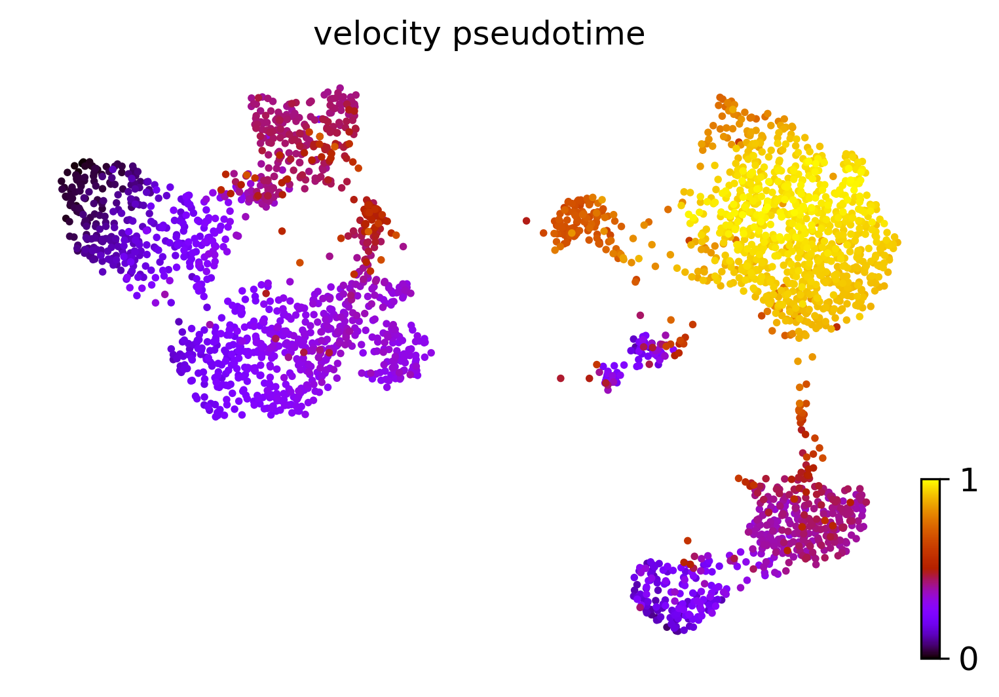

In [101]:
scv.tl.velocity_pseudotime(pou1f1_lineage)
scv.pl.scatter(pou1f1_lineage, color='velocity_pseudotime', cmap='gnuplot')

In [109]:
sc.tl.leiden(pou1f1_lineage)

In [112]:
pou1f1_lineage.uns['neighbors']['distances'] = pou1f1_lineage.obsp['distances']
pou1f1_lineage.uns['neighbors']['connectivities'] = pou1f1_lineage.obsp['connectivities']

In [113]:
scv.tl.paga(pou1f1_lineage, groups='leiden')
# df = scv.get_df(pou1f1_lineage, 'paga/transitions_confidence', precision=2).T

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


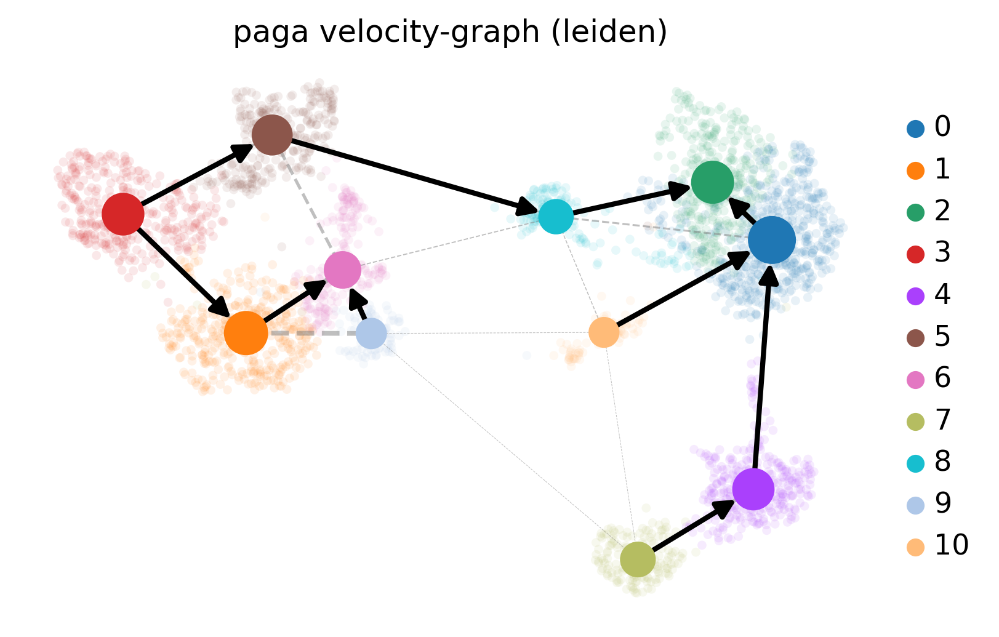

In [114]:
scv.pl.paga(pou1f1_lineage, basis='umap', size=50, alpha=.1,
           min_edge_width=2, node_size_scale=1.5)

# Step 5: Analyzing Pou1f1-independent lineage cells

In [79]:
non_pou1f1_lineage = adata[adata.obs.cell_type_brief.isin(['Gonad','Cort','Mel'])]
non_pou1f1_lineage = non_pou1f1_lineage[non_pou1f1_lineage.obs.treat.isin(['Saline','LPS'])]

In [80]:
sc.pp.normalize_total(non_pou1f1_lineage, target_sum=1e4)
sc.pp.log1p(non_pou1f1_lineage)
sc.pp.highly_variable_genes(non_pou1f1_lineage, min_mean=0.0125, max_mean=3, min_disp=0.5)
non_pou1f1_lineage.raw = non_pou1f1_lineage
non_pou1f1_lineage = non_pou1f1_lineage[:, non_pou1f1_lineage.var.highly_variable]
sc.pp.regress_out(non_pou1f1_lineage, ['nCount_RNA','subsets_Mito_detected','subsets_Ribo_detected'])
sc.pp.scale(non_pou1f1_lineage, max_value=10)

In [81]:
sc.tl.pca(non_pou1f1_lineage, svd_solver='arpack')
sc.pp.neighbors(non_pou1f1_lineage, n_neighbors=15, n_pcs=50)
sc.tl.umap(non_pou1f1_lineage)

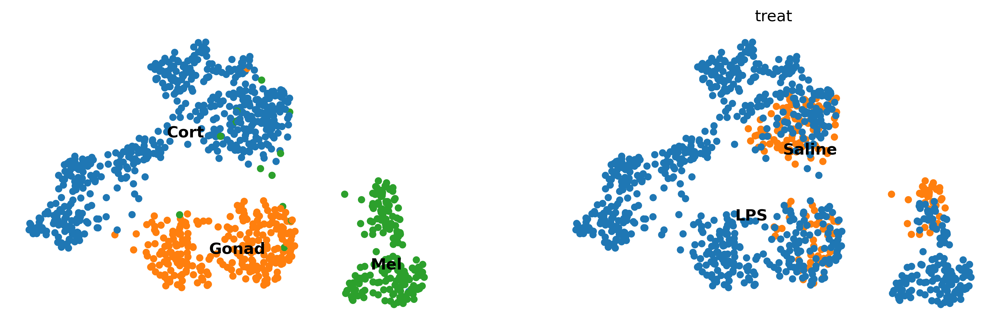

In [82]:
# plot umap to check
sc.pl.umap(non_pou1f1_lineage, color=['cell_type_brief','treat'], frameon=False, legend_loc='on data', title='')

In [83]:
scv.pp.filter_and_normalize(non_pou1f1_lineage, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(non_pou1f1_lineage, n_pcs=30, n_neighbors=30)

Filtered out 6290 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [84]:
scv.tl.recover_dynamics(non_pou1f1_lineage)

recovering dynamics (using 1/48 cores)


  0%|          | 0/68 [00:00<?, ?gene/s]

    finished (0:00:10) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [85]:
scv.tl.velocity(non_pou1f1_lineage, mode='dynamical')
scv.tl.velocity_graph(non_pou1f1_lineage)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/48 cores)


  0%|          | 0/970 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


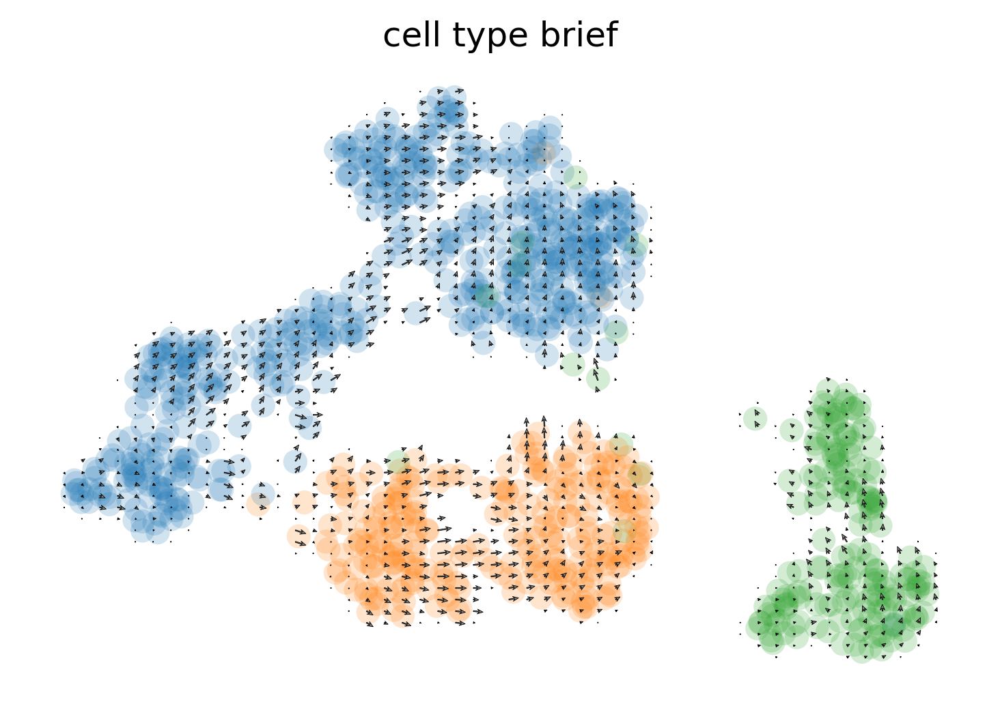

In [86]:
scv.pl.velocity_embedding_grid(non_pou1f1_lineage, color='cell_type_brief', basis='umap')

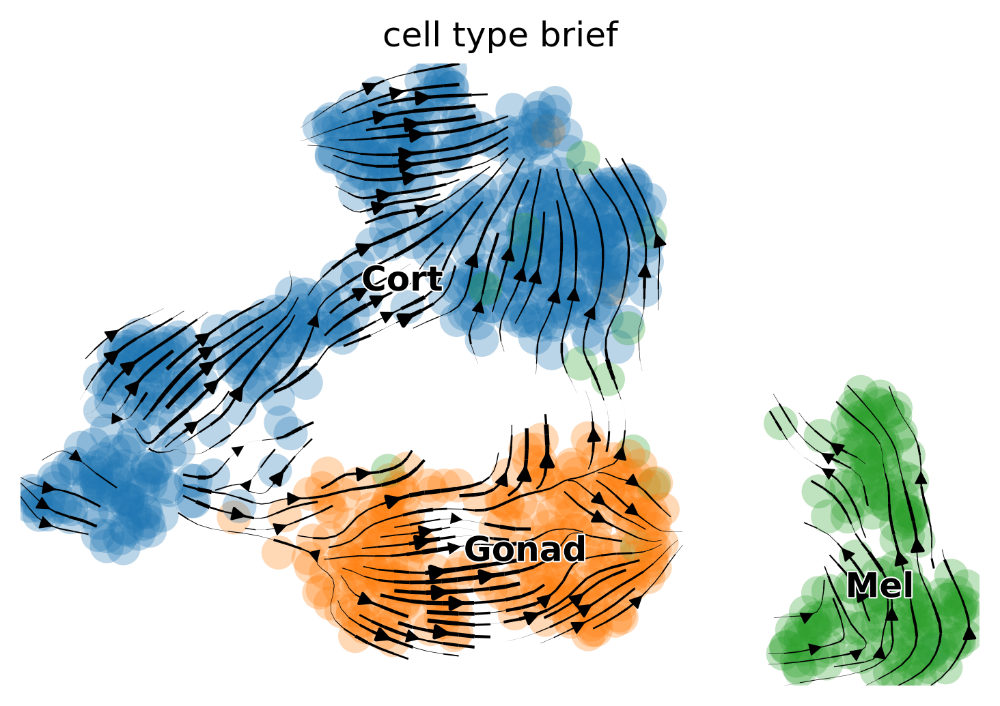

In [87]:
scv.pl.velocity_embedding_stream(non_pou1f1_lineage, color='cell_type_brief', basis='umap')

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


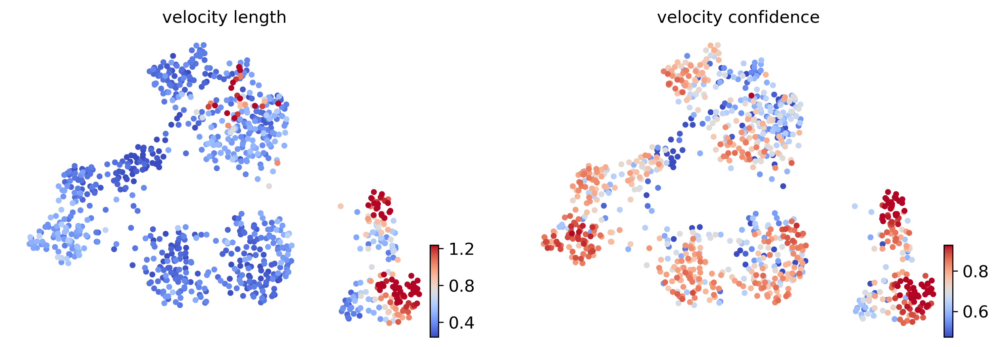

In [115]:
scv.tl.velocity_confidence(non_pou1f1_lineage)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(non_pou1f1_lineage, c=keys, cmap='coolwarm', perc=[5,95])

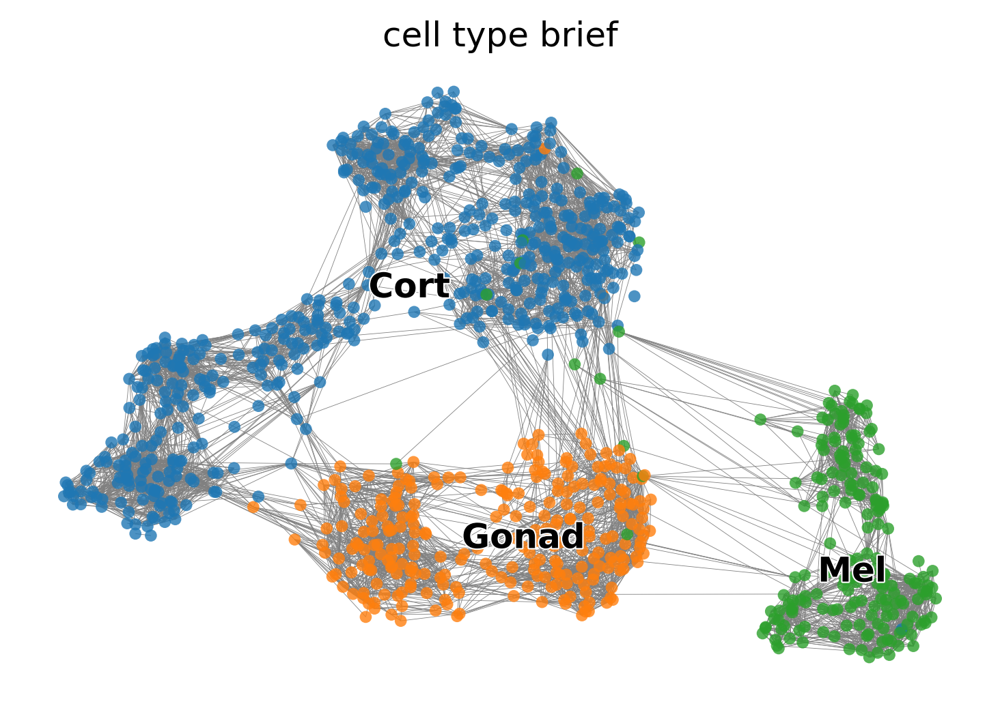

In [116]:
scv.pl.velocity_graph(non_pou1f1_lineage, threshold=.1, color='cell_type_brief', legend_loc='on data')

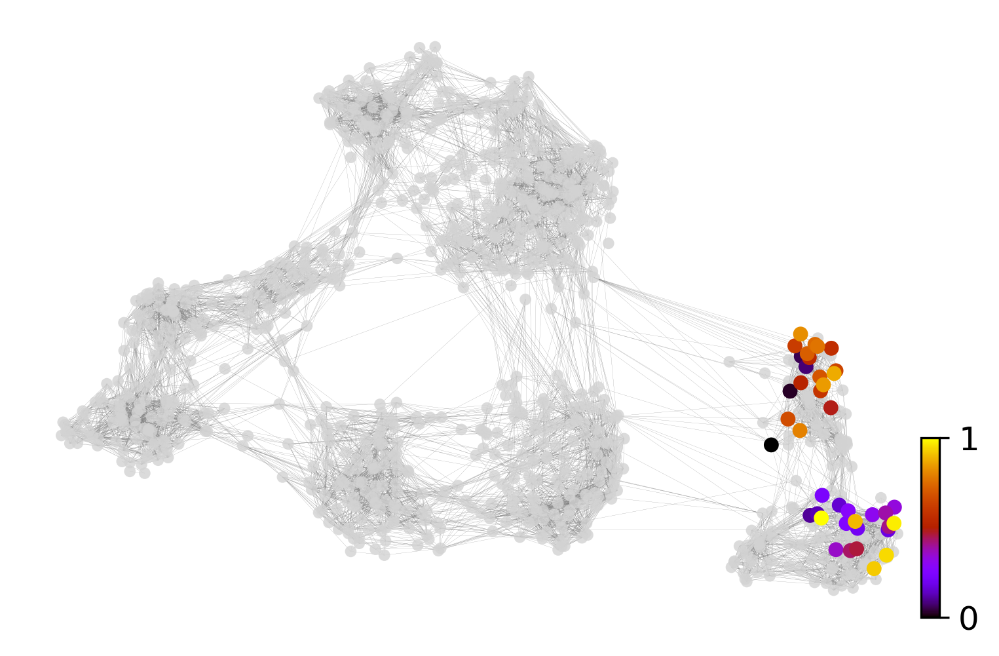

In [117]:
x, y = scv.utils.get_cell_transitions(non_pou1f1_lineage, basis='umap', starting_cell=1)
ax = scv.pl.velocity_graph(non_pou1f1_lineage, c='lightgrey', edge_width=.05, show=False)
ax = scv.pl.scatter(non_pou1f1_lineage, x=x, y=y, s=120, c='ascending', cmap='gnuplot', ax=ax)

computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


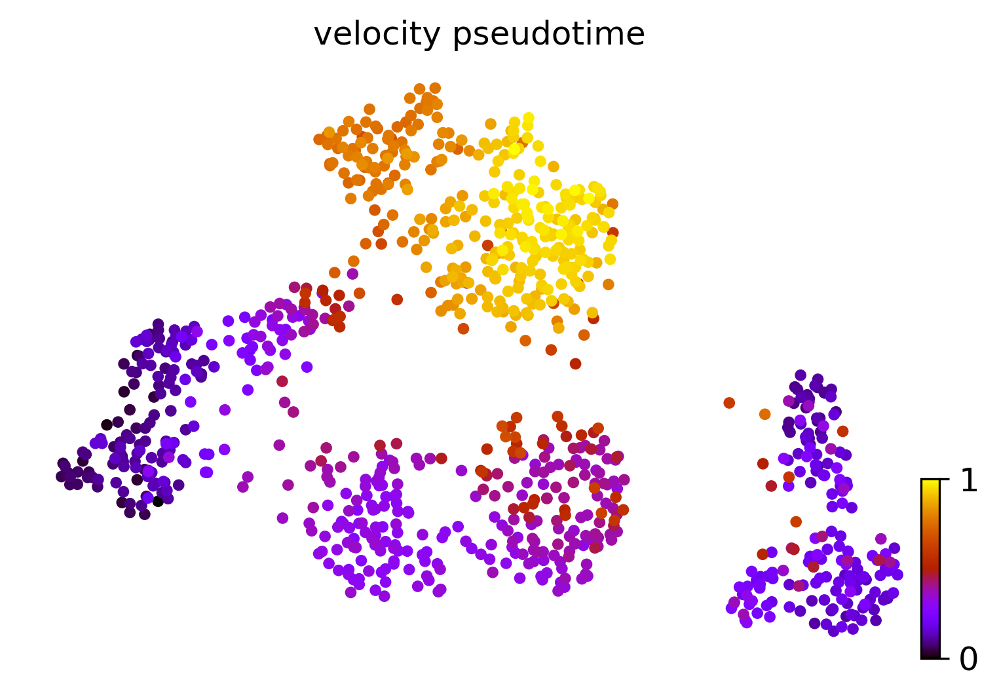

In [118]:
scv.tl.velocity_pseudotime(non_pou1f1_lineage)
scv.pl.scatter(non_pou1f1_lineage, color='velocity_pseudotime', cmap='gnuplot')

In [119]:
sc.tl.leiden(non_pou1f1_lineage)

In [123]:
non_pou1f1_lineage.uns['neighbors']['distances'] = non_pou1f1_lineage.obsp['distances']
non_pou1f1_lineage.uns['neighbors']['connectivities'] = non_pou1f1_lineage.obsp['connectivities']

In [124]:
scv.tl.paga(non_pou1f1_lineage, groups='leiden')
# df = scv.get_df(pou1f1_lineage, 'paga/transitions_confidence', precision=2).T

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


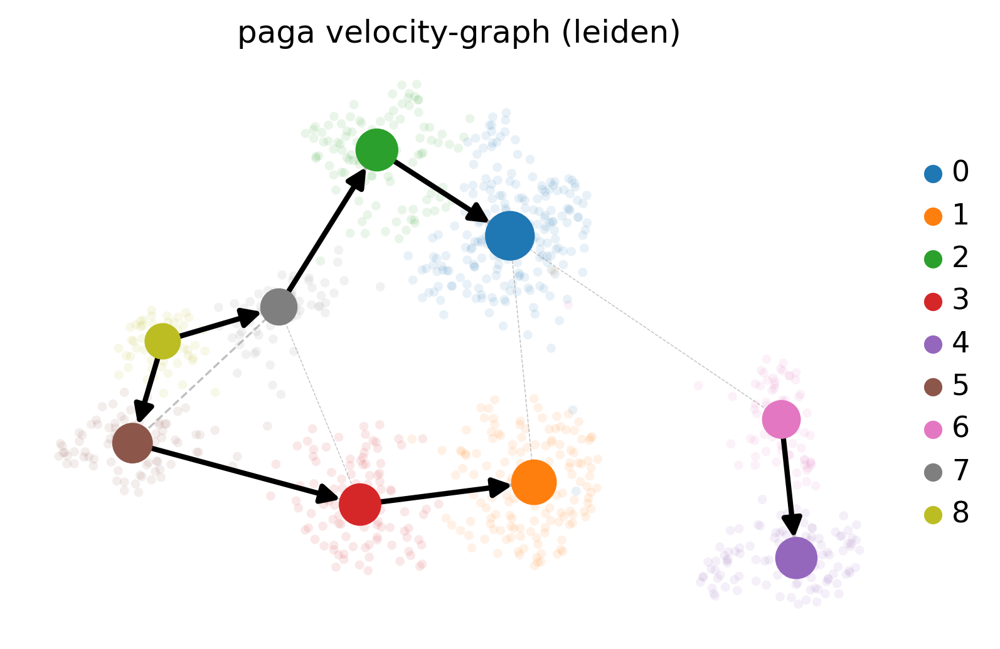

In [125]:
scv.pl.paga(non_pou1f1_lineage, basis='umap', size=50, alpha=.1,
           min_edge_width=2, node_size_scale=1.5)